<a href="https://colab.research.google.com/github/abdielgv162/Data-Science-Machine-Learning/blob/master/IA_notebook_Dot_CSV/Copia_de_VQGAN%2BCLIP_(z%2Bquantize_method_con_augmentations).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Genera imágenes desde frases de texto con VQGAN y CLIP (método z+quantize con augmentations).

Notebook hecho por Katherine Crowson (https://github.com/crowsonkb, https://twitter.com/RiversHaveWings). El método BigGAN+CLIP original fue hecho por https://twitter.com/advadnoun. Traducido y agregadas algunas explicaciones y modificaciones por Eleiber#8347.


In [1]:
# @title Licensed under the MIT License

# Copyright (c) 2021 Katherine Crowson

# Permission is hereby granted, free of charge, to any person obtaining a copy
# of this software and associated documentation files (the "Software"), to deal
# in the Software without restriction, including without limitation the rights
# to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
# copies of the Software, and to permit persons to whom the Software is
# furnished to do so, subject to the following conditions:

# The above copyright notice and this permission notice shall be included in
# all copies or substantial portions of the Software.

# THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
# IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
# FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
# AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
# LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
# OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN
# THE SOFTWARE.


In [2]:
!nvidia-smi

Tue Jun  1 14:16:26 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   47C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
!git clone https://github.com/openai/CLIP
!git clone https://github.com/CompVis/taming-transformers
!pip install ftfy regex tqdm omegaconf pytorch-lightning
!pip install kornia
!pip install imageio-ffmpeg
!mkdir steps

Cloning into 'CLIP'...
remote: Enumerating objects: 90, done.
remote: Total 90 (delta 0), reused 0 (delta 0), pack-reused 90
Unpacking objects: 100% (90/90), done.
Cloning into 'taming-transformers'...
remote: Enumerating objects: 685, done.
remote: Counting objects: 100% (27/27), done.
remote: Compressing objects: 100% (21/21), done.
remote: Total 685 (delta 9), reused 19 (delta 6), pack-reused 658
Receiving objects: 100% (685/685), 116.29 MiB | 32.74 MiB/s, done.
Resolving deltas: 100% (144/144), done.
     |████████████████████████████████| 71kB 5.1MB/s 
     |████████████████████████████████| 808kB 16.6MB/s 
     |████████████████████████████████| 645kB 52.0MB/s 
     |████████████████████████████████| 829kB 52.0MB/s 
     |████████████████████████████████| 10.6MB 44.4MB/s 
     |████████████████████████████████| 276kB 48.1MB/s 
     |████████████████████████████████| 112kB 57.5MB/s 
     |████████████████████████████████| 1.3MB 39.8MB/s 
     |████████████████████████████████| 296

Por defecto, el notebook descarga los modelos 1024 y 16384 de ImageNet. Existen otros como COCO-Stuff, WikiArt o S-FLCKR, que son pesados, y si no los vas a usar sería en vano descargarlos, así que si quieres usarlos, simplemente quita los numerales al principio de las líneas dependiendo del modelo que quieras (el nombre del modelo está al final de las líneas).

In [4]:
!curl -L 'https://heibox.uni-heidelberg.de/d/8088892a516d4e3baf92/files/?p=%2Fconfigs%2Fmodel.yaml&dl=1' > vqgan_imagenet_f16_1024.yaml #ImageNet 1024
!curl -L 'https://heibox.uni-heidelberg.de/d/8088892a516d4e3baf92/files/?p=%2Fckpts%2Flast.ckpt&dl=1' > vqgan_imagenet_f16_1024.ckpt #ImageNet 1024

!curl -L 'https://heibox.uni-heidelberg.de/d/a7530b09fed84f80a887/files/?p=%2Fconfigs%2Fmodel.yaml&dl=1' > vqgan_imagenet_f16_16384.yaml #ImageNet 16384
!curl -L 'https://heibox.uni-heidelberg.de/d/a7530b09fed84f80a887/files/?p=%2Fckpts%2Flast.ckpt&dl=1' > vqgan_imagenet_f16_16384.ckpt #ImageNet 16384

#!curl -L 'https://dl.nmkd.de/ai/clip/coco/coco.yaml' > coco.yaml #COCO
#!curl -L 'https://dl.nmkd.de/ai/clip/coco/coco.ckpt' > coco.ckpt #COCO

#!curl -L 'https://app.koofr.net/links/a04deec9-0c59-4673-8b37-3d696fe63a5d?path=%2F2020-11-13T21-41-45_faceshq_transformer%2Fconfigs%2F2020-11-13T21-41-45-project.yaml' > faceshq.yaml #FacesHQ
#!curl -L 'https://app.koofr.net/content/links/a04deec9-0c59-4673-8b37-3d696fe63a5d/files/get/last.ckpt?path=%2F2020-11-13T21-41-45_faceshq_transformer%2Fcheckpoints%2Flast.ckpt' > faceshq.ckpt #FacesHQ

#!curl -L 'http://dl.nmkd.de/ai/clip/wikiart-vqgan/WikiArt_augmented_Steps_7mil_finetuned_1mil.yaml' > wikiart.yaml #WikiArt
#!curl -L 'http://dl.nmkd.de/ai/clip/wikiart-vqgan/WikiArt_augmented_Steps_7mil_finetuned_1mil.ckpt' > wikiart.ckpt #WikiArt

#!curl -L 'https://heibox.uni-heidelberg.de/d/73487ab6e5314cb5adba/files/?p=%2Fconfigs%2F2020-11-09T13-31-51-project.yaml&dl=1' > sflckr.yaml #S-FLCKR
#!curl -L 'https://heibox.uni-heidelberg.de/d/73487ab6e5314cb5adba/files/?p=%2Fcheckpoints%2Flast.ckpt&dl=1' > sflckr.ckpt #S-FLCKR

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100   645  100   645    0     0    987      0 --:--:-- --:--:-- --:--:--   987
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100  913M  100  913M    0     0  14.4M      0  0:01:03  0:01:03 --:--:-- 14.8M
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:--  0:00:01 --:--:--     0
100   692  100   692    0     0    497      0  0:00:01  0:00:01 --:--:--   497
  % Total    % Received % Xferd  Average Speed   Tim

In [5]:
import argparse
import math
from pathlib import Path
import sys

sys.path.append('./taming-transformers')

from IPython import display
from omegaconf import OmegaConf
from PIL import Image
from taming.models import cond_transformer, vqgan
import torch
from torch import nn, optim
from torch.nn import functional as F
from torchvision import transforms
from torchvision.transforms import functional as TF
from tqdm.notebook import tqdm

from CLIP import clip
import kornia.augmentation as K
from base64 import b64encode
import numpy as np
import imageio


In [6]:
def sinc(x):
    return torch.where(x != 0, torch.sin(math.pi * x) / (math.pi * x), x.new_ones([]))


def lanczos(x, a):
    cond = torch.logical_and(-a < x, x < a)
    out = torch.where(cond, sinc(x) * sinc(x/a), x.new_zeros([]))
    return out / out.sum()


def ramp(ratio, width):
    n = math.ceil(width / ratio + 1)
    out = torch.empty([n])
    cur = 0
    for i in range(out.shape[0]):
        out[i] = cur
        cur += ratio
    return torch.cat([-out[1:].flip([0]), out])[1:-1]


def resample(input, size, align_corners=True):
    n, c, h, w = input.shape
    dh, dw = size

    input = input.view([n * c, 1, h, w])

    if dh < h:
        kernel_h = lanczos(ramp(dh / h, 2), 2).to(input.device, input.dtype)
        pad_h = (kernel_h.shape[0] - 1) // 2
        input = F.pad(input, (0, 0, pad_h, pad_h), 'reflect')
        input = F.conv2d(input, kernel_h[None, None, :, None])

    if dw < w:
        kernel_w = lanczos(ramp(dw / w, 2), 2).to(input.device, input.dtype)
        pad_w = (kernel_w.shape[0] - 1) // 2
        input = F.pad(input, (pad_w, pad_w, 0, 0), 'reflect')
        input = F.conv2d(input, kernel_w[None, None, None, :])

    input = input.view([n, c, h, w])
    return F.interpolate(input, size, mode='bicubic', align_corners=align_corners)


class ReplaceGrad(torch.autograd.Function):
    @staticmethod
    def forward(ctx, x_forward, x_backward):
        ctx.shape = x_backward.shape
        return x_forward

    @staticmethod
    def backward(ctx, grad_in):
        return None, grad_in.sum_to_size(ctx.shape)


replace_grad = ReplaceGrad.apply


class ClampWithGrad(torch.autograd.Function):
    @staticmethod
    def forward(ctx, input, min, max):
        ctx.min = min
        ctx.max = max
        ctx.save_for_backward(input)
        return input.clamp(min, max)

    @staticmethod
    def backward(ctx, grad_in):
        input, = ctx.saved_tensors
        return grad_in * (grad_in * (input - input.clamp(ctx.min, ctx.max)) >= 0), None, None


clamp_with_grad = ClampWithGrad.apply


def vector_quantize(x, codebook):
    d = x.pow(2).sum(dim=-1, keepdim=True) + codebook.pow(2).sum(dim=1) - 2 * x @ codebook.T
    indices = d.argmin(-1)
    x_q = F.one_hot(indices, codebook.shape[0]).to(d.dtype) @ codebook
    return replace_grad(x_q, x)


class Prompt(nn.Module):
    def __init__(self, embed, weight=1., stop=float('-inf')):
        super().__init__()
        self.register_buffer('embed', embed)
        self.register_buffer('weight', torch.as_tensor(weight))
        self.register_buffer('stop', torch.as_tensor(stop))

    def forward(self, input):
        input_normed = F.normalize(input.unsqueeze(1), dim=2)
        embed_normed = F.normalize(self.embed.unsqueeze(0), dim=2)
        dists = input_normed.sub(embed_normed).norm(dim=2).div(2).arcsin().pow(2).mul(2)
        dists = dists * self.weight.sign()
        return self.weight.abs() * replace_grad(dists, torch.maximum(dists, self.stop)).mean()


def parse_prompt(prompt):
    vals = prompt.rsplit(':', 2)
    vals = vals + ['', '1', '-inf'][len(vals):]
    return vals[0], float(vals[1]), float(vals[2])


class MakeCutouts(nn.Module):
    def __init__(self, cut_size, cutn, cut_pow=1.):
        super().__init__()
        self.cut_size = cut_size
        self.cutn = cutn
        self.cut_pow = cut_pow
        self.augs = nn.Sequential(
            K.RandomHorizontalFlip(p=0.5),
            K.ColorJitter(hue=0.01, saturation=0.01, p=0.7),
            # K.RandomSolarize(0.01, 0.01, p=0.7),
            K.RandomSharpness(0.3,p=0.4),
            K.RandomAffine(degrees=30, translate=0.1, p=0.8, padding_mode='border'),
            K.RandomPerspective(0.2,p=0.4),)
        self.noise_fac = 0.1


    def forward(self, input):
        sideY, sideX = input.shape[2:4]
        max_size = min(sideX, sideY)
        min_size = min(sideX, sideY, self.cut_size)
        cutouts = []
        for _ in range(self.cutn):
            size = int(torch.rand([])**self.cut_pow * (max_size - min_size) + min_size)
            offsetx = torch.randint(0, sideX - size + 1, ())
            offsety = torch.randint(0, sideY - size + 1, ())
            cutout = input[:, :, offsety:offsety + size, offsetx:offsetx + size]
            cutouts.append(resample(cutout, (self.cut_size, self.cut_size)))
        batch = self.augs(torch.cat(cutouts, dim=0))
        if self.noise_fac:
            facs = batch.new_empty([self.cutn, 1, 1, 1]).uniform_(0, self.noise_fac)
            batch = batch + facs * torch.randn_like(batch)
        return batch



def load_vqgan_model(config_path, checkpoint_path):
    config = OmegaConf.load(config_path)
    if config.model.target == 'taming.models.vqgan.VQModel':
        model = vqgan.VQModel(**config.model.params)
        model.eval().requires_grad_(False)
        model.init_from_ckpt(checkpoint_path)
    elif config.model.target == 'taming.models.cond_transformer.Net2NetTransformer':
        parent_model = cond_transformer.Net2NetTransformer(**config.model.params)
        parent_model.eval().requires_grad_(False)
        parent_model.init_from_ckpt(checkpoint_path)
        model = parent_model.first_stage_model
    else:
        raise ValueError(f'unknown model type: {config.model.target}')
    del model.loss
    return model


def resize_image(image, out_size):
    ratio = image.size[0] / image.size[1]
    area = min(image.size[0] * image.size[1], out_size[0] * out_size[1])
    size = round((area * ratio)**0.5), round((area / ratio)**0.5)
    return image.resize(size, Image.LANCZOS)


## Herramientas para la ejecución:
Principalmente lo que tendrás que modificar será la variable `prompts=['']`, dentro de las comillas simples pondrás el texto que quieres generar. Es una lista porque puedes poner más de un texto, y así la IA trate de 'mezclar' las imágenes, dándole la misma prioridad a ambos textos.

Para usar una imagen inicial al modelo, solo debes subir un archivo al entorno del Colab (en la sección a la izquierda), y luego modificas la variable `init_image=None` poniendo entre las comillas el nombre exacto del archivo. Ejemplo: `init_image='sample.png'`

También puedes modificar el modelo cambiando las líneas `vqgan_config=` y `vqgan_checkpoint=` respectivamente, actualmente están disponibles 1024, 16384, WikiArt, S-FLCKR y COCO-Stuff. Para activarlos tienes que haberlos descargado primero, y luego puedes guiarte de esto, reemplazando solo lo que viene antes del `.yaml` o del `.ckpt`. FacesHQ no lo he probado por lo que podría no funcionar.

VQGAN ImageNet 1024: `vqgan_imagenet_f16_1024`

VQGAN ImageNet 16384: `vqgan_imagenet_f16_16384`

COCO-Stuff: `coco`

S-FLCKR: `sflckr`

WikiArt: `wikiart`

FacesHQ: `faceshq`

In [7]:
args = argparse.Namespace(
    prompts=['quantum computing'],
    image_prompts=[],
    noise_prompt_seeds=[],
    noise_prompt_weights=[],
    size=[480, 480],
    init_image=None,
    init_weight=0.,
    clip_model='ViT-B/32',
    vqgan_config='vqgan_imagenet_f16_16384.yaml',
    vqgan_checkpoint='vqgan_imagenet_f16_16384.ckpt',
    step_size=0.1,
    cutn=64,
    cut_pow=1.,
    display_freq=50,
    seed=None,
)

### Hacer la ejecución...

Using device: cuda:0
Working with z of shape (1, 256, 16, 16) = 65536 dimensions.


Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


8.19kB [00:00, 186kB/s]                    


loaded pretrained LPIPS loss from taming/modules/autoencoder/lpips/vgg.pth
VQLPIPSWithDiscriminator running with hinge loss.
Restored from vqgan_imagenet_f16_16384.ckpt


100%|████████████████████████████████████████| 354M/354M [00:01<00:00, 188MiB/s]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:258: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  "Argument interpolation should be of type InterpolationMode instead of int. "


i: 0, loss: 0.89958, losses: 0.89958


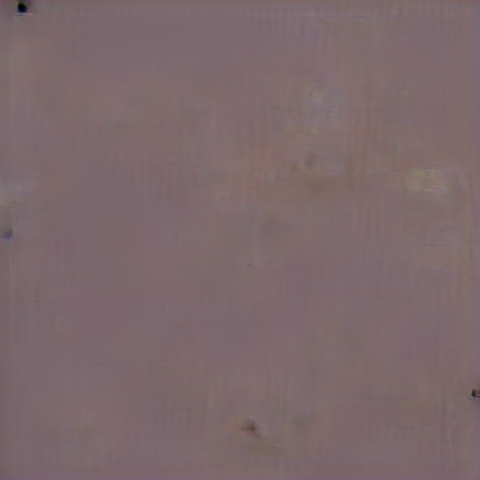

i: 50, loss: 0.800876, losses: 0.800876


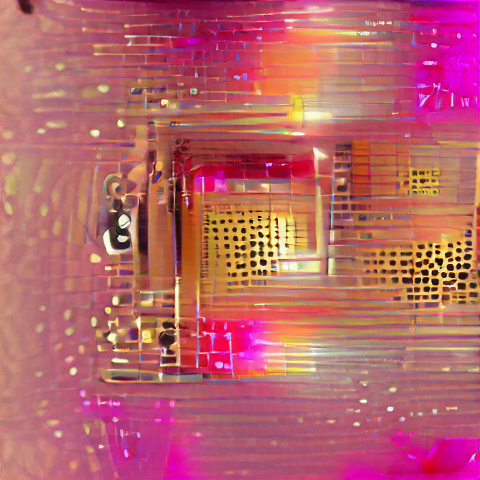

i: 100, loss: 0.745507, losses: 0.745507


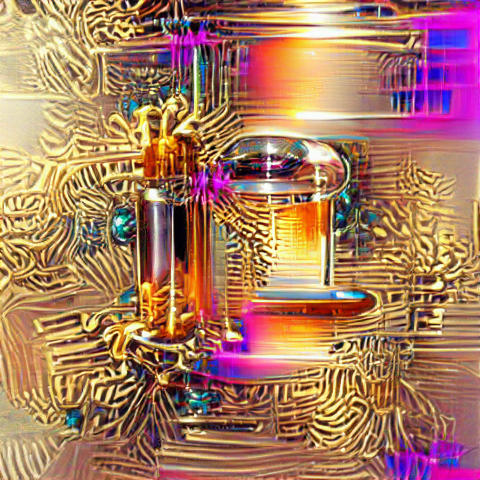

i: 150, loss: 0.73369, losses: 0.73369


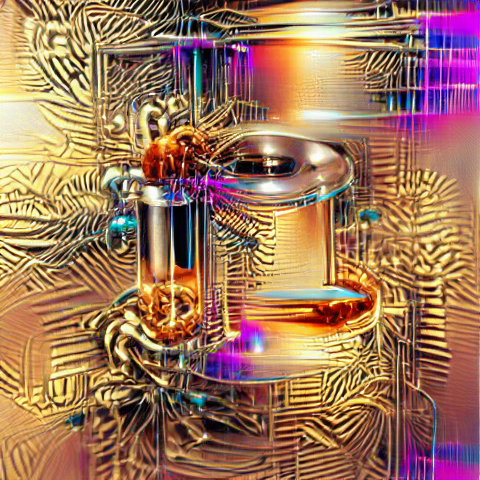

i: 200, loss: 0.726174, losses: 0.726174


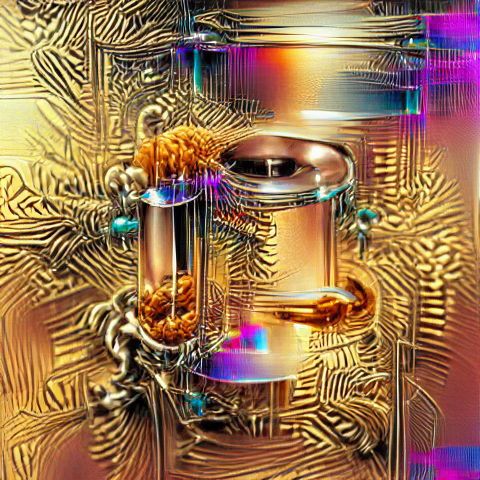

i: 250, loss: 0.719502, losses: 0.719502


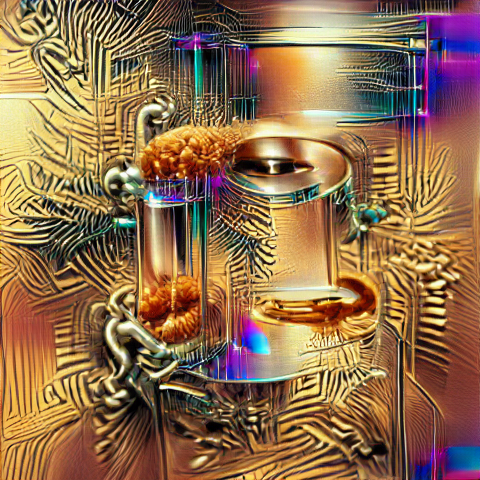

i: 300, loss: 0.716367, losses: 0.716367


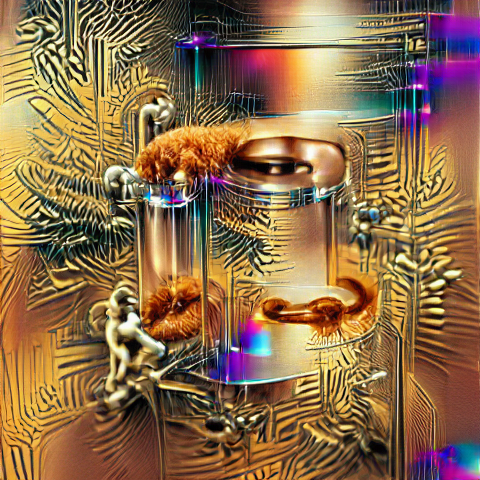

i: 350, loss: 0.713887, losses: 0.713887


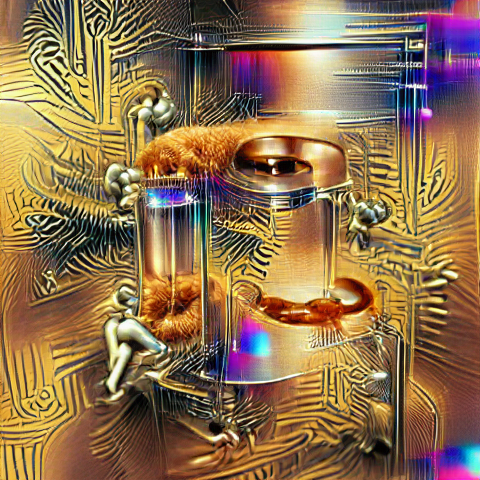

i: 400, loss: 0.711362, losses: 0.711362


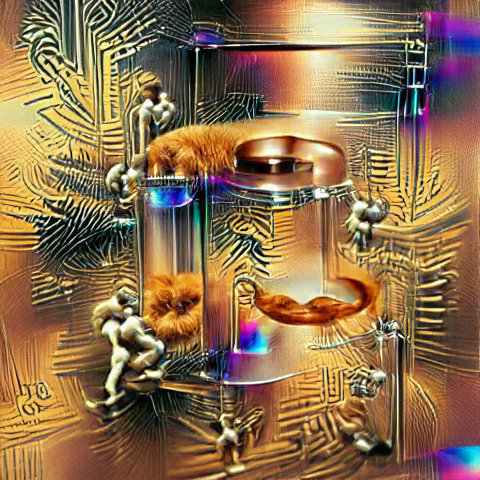

i: 450, loss: 0.710155, losses: 0.710155


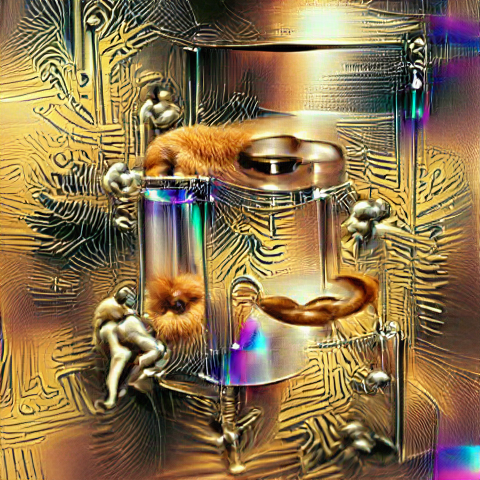

i: 500, loss: 0.70587, losses: 0.70587


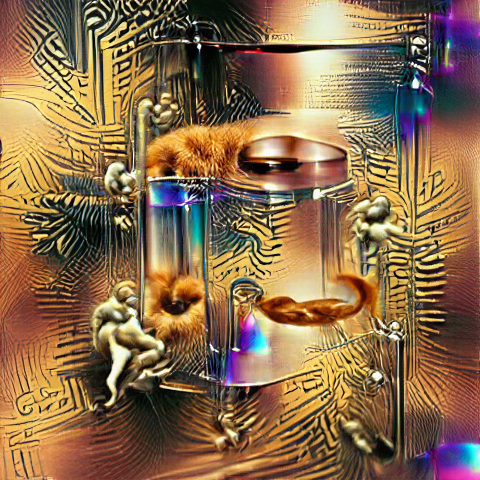

i: 550, loss: 0.73736, losses: 0.73736


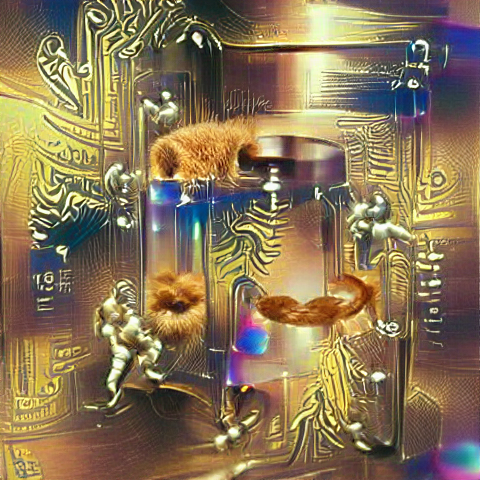

i: 600, loss: 0.743892, losses: 0.743892


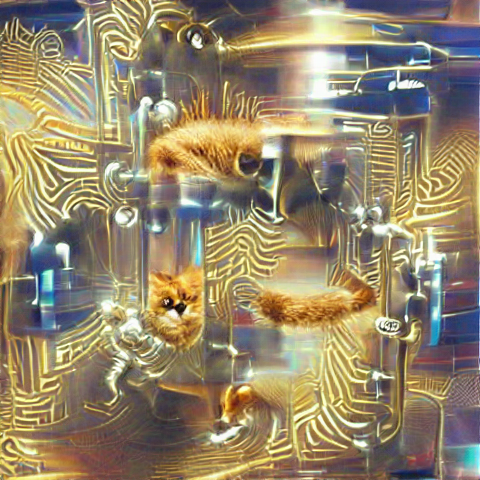

i: 650, loss: 0.730425, losses: 0.730425


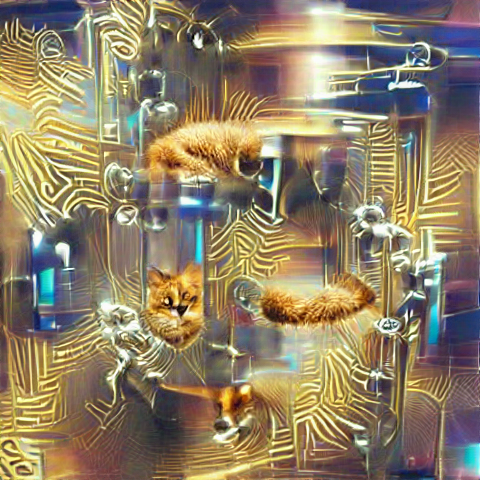

i: 700, loss: 0.728534, losses: 0.728534


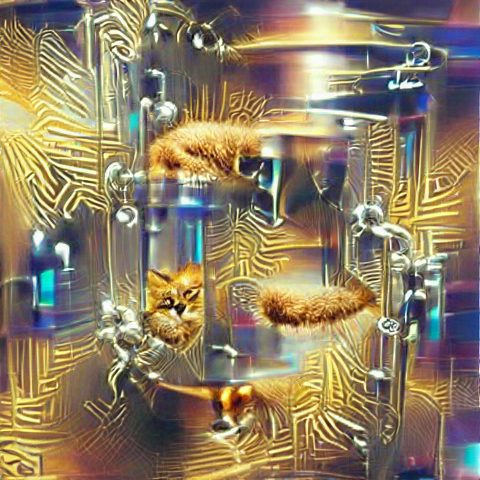

i: 750, loss: 0.725212, losses: 0.725212


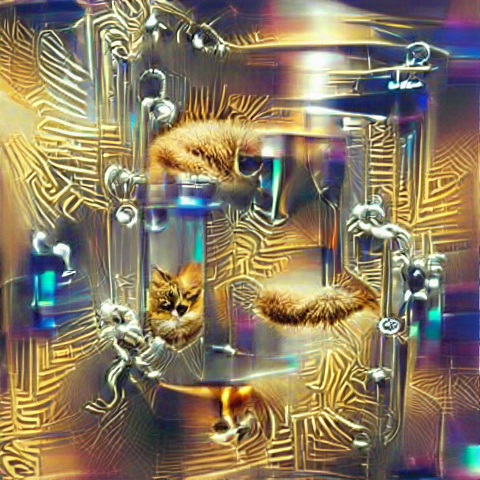

i: 800, loss: 0.71973, losses: 0.71973


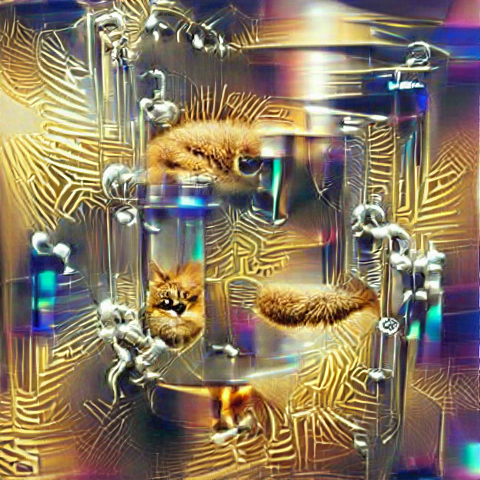

i: 850, loss: 0.720376, losses: 0.720376


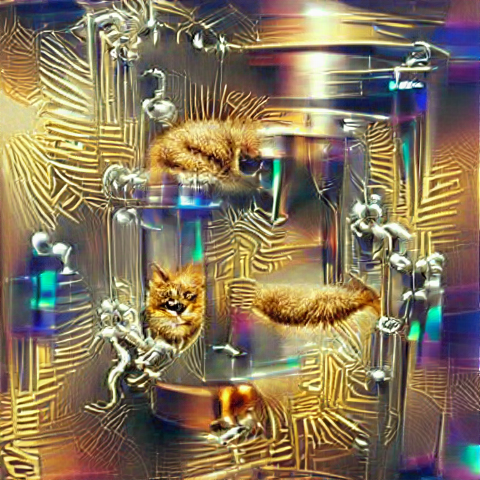

i: 900, loss: 0.716777, losses: 0.716777


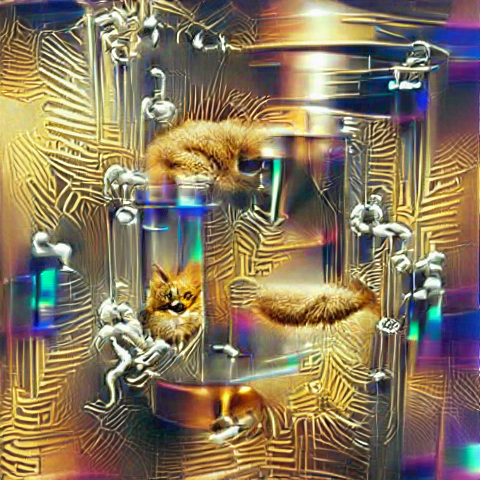

i: 950, loss: 0.715332, losses: 0.715332


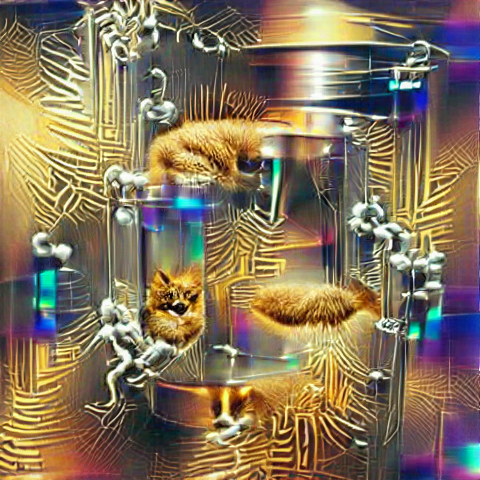

i: 1000, loss: 0.714531, losses: 0.714531


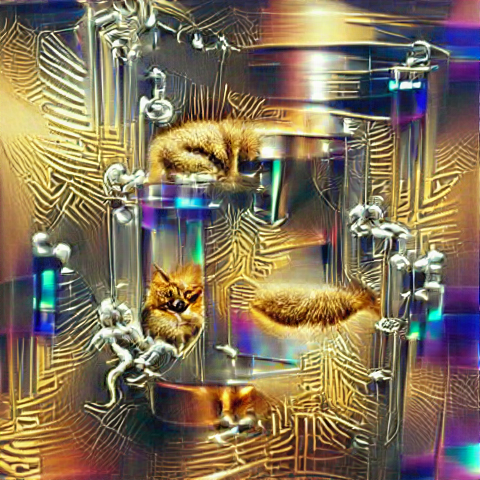

i: 1050, loss: 0.713897, losses: 0.713897


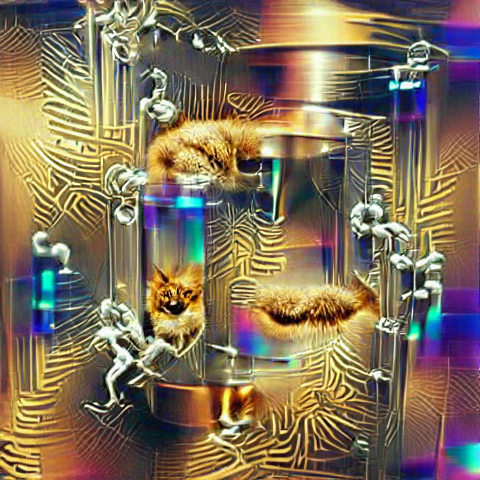

i: 1100, loss: 0.712268, losses: 0.712268


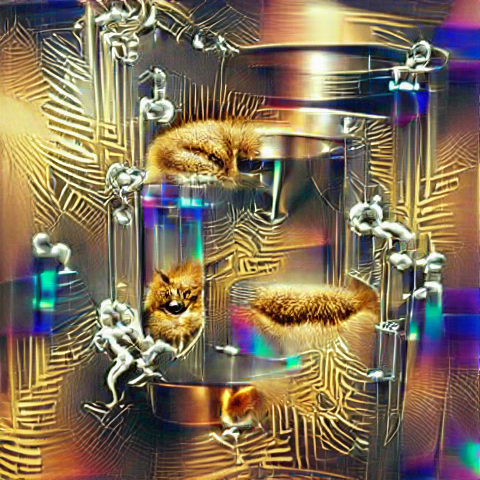

i: 1150, loss: 0.716458, losses: 0.716458


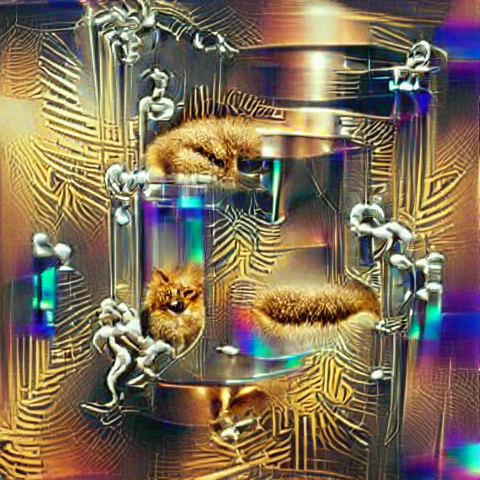

i: 1200, loss: 0.711715, losses: 0.711715


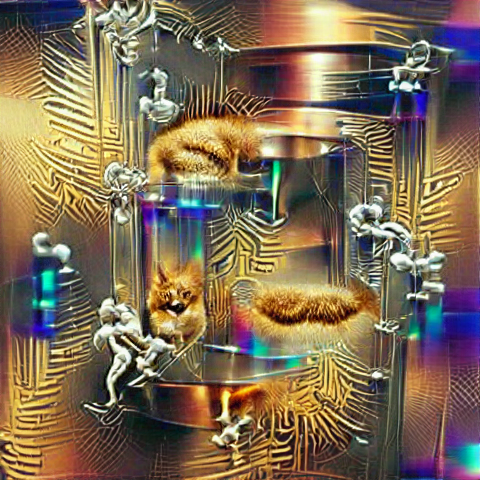

i: 1250, loss: 0.710284, losses: 0.710284


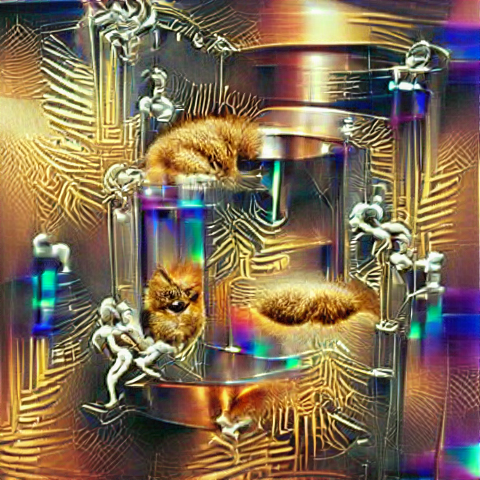

i: 1300, loss: 0.709255, losses: 0.709255


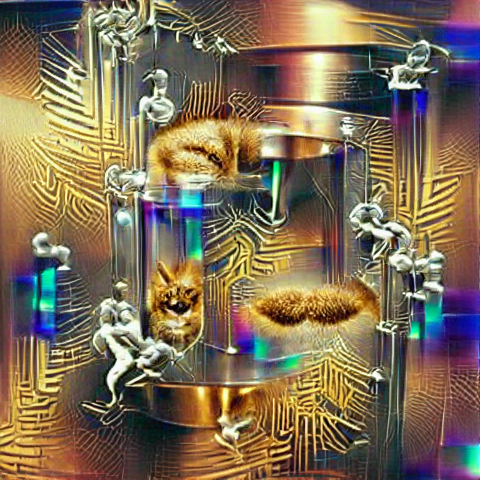

i: 1350, loss: 0.709087, losses: 0.709087


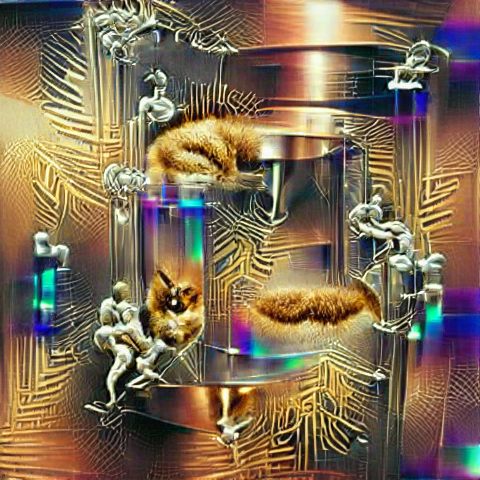

i: 1400, loss: 0.70496, losses: 0.70496


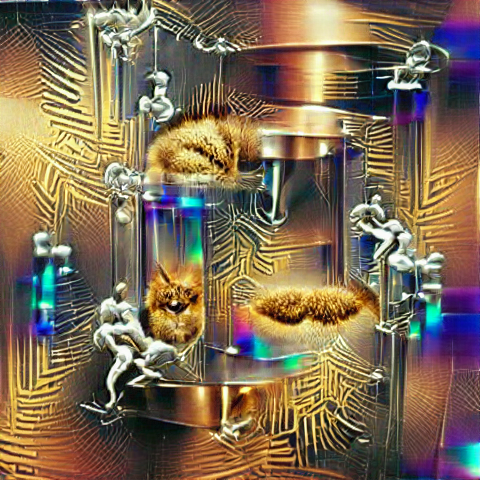

i: 1450, loss: 0.705609, losses: 0.705609


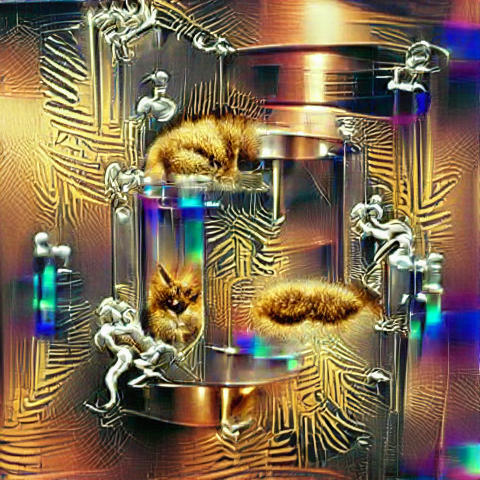

i: 1500, loss: 0.706481, losses: 0.706481


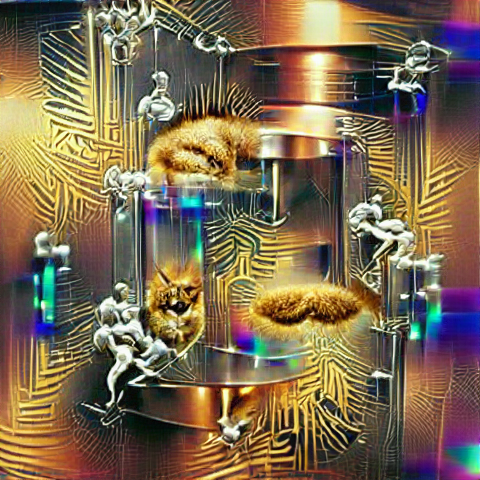

i: 1550, loss: 0.706974, losses: 0.706974


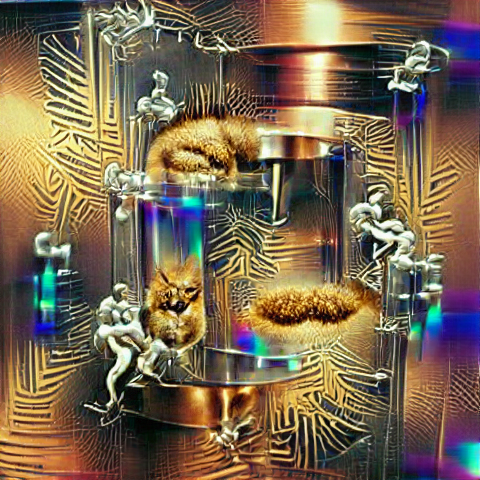

i: 1600, loss: 0.70643, losses: 0.70643


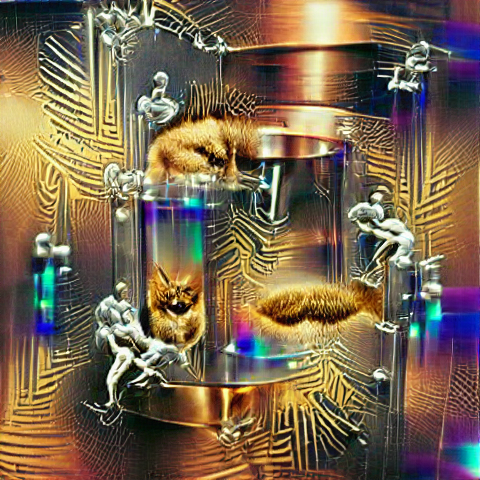

i: 1650, loss: 0.701406, losses: 0.701406


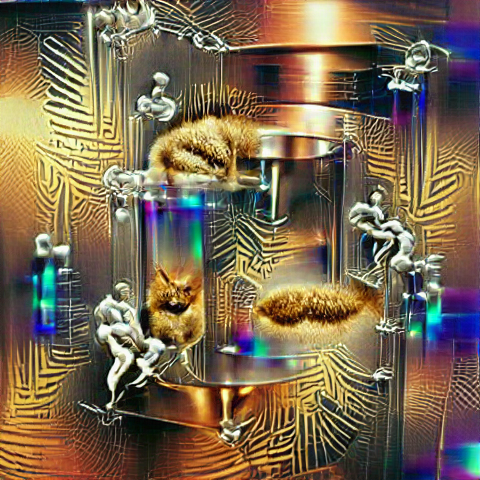

i: 1700, loss: 0.707281, losses: 0.707281


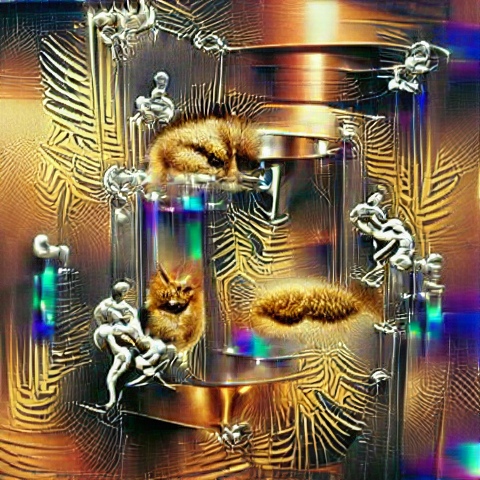

i: 1750, loss: 0.708082, losses: 0.708082


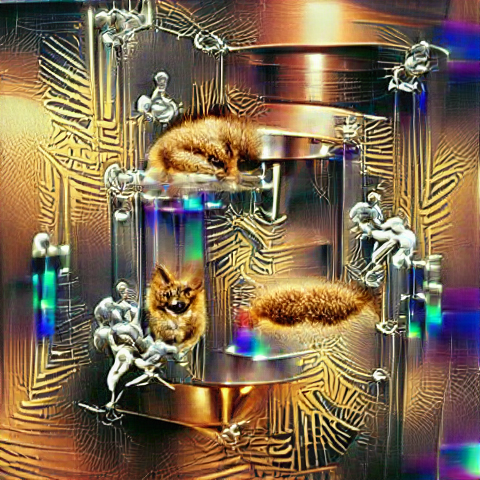

i: 1800, loss: 0.706666, losses: 0.706666


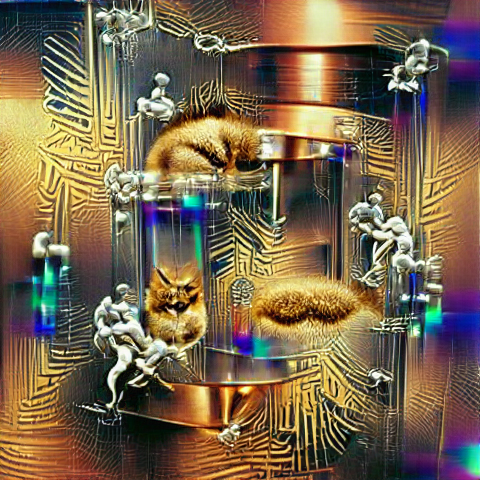

i: 1850, loss: 0.703571, losses: 0.703571


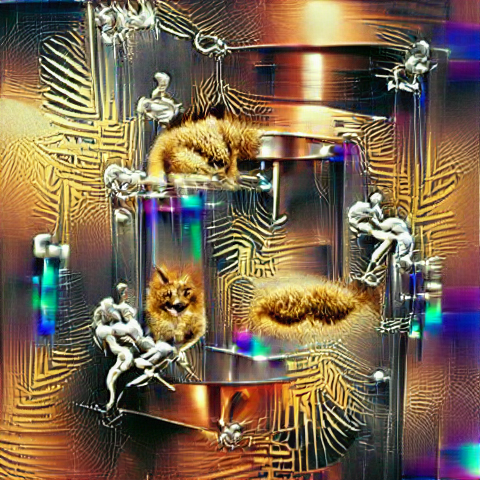

i: 1900, loss: 0.699722, losses: 0.699722


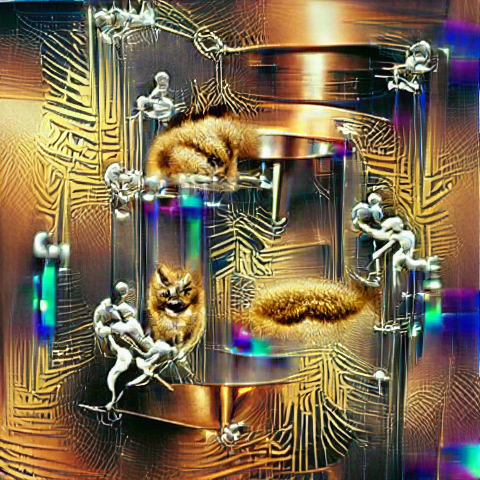

i: 1950, loss: 0.699882, losses: 0.699882


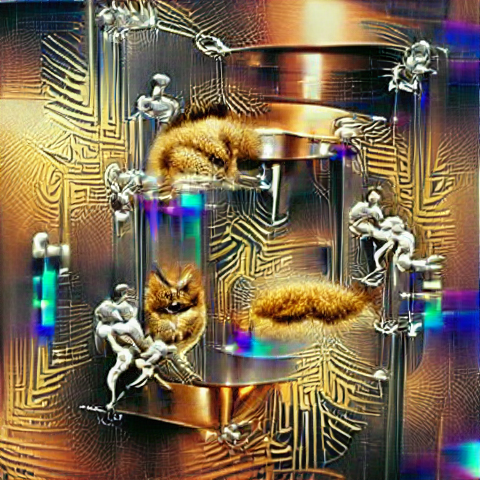

i: 2000, loss: 0.702117, losses: 0.702117


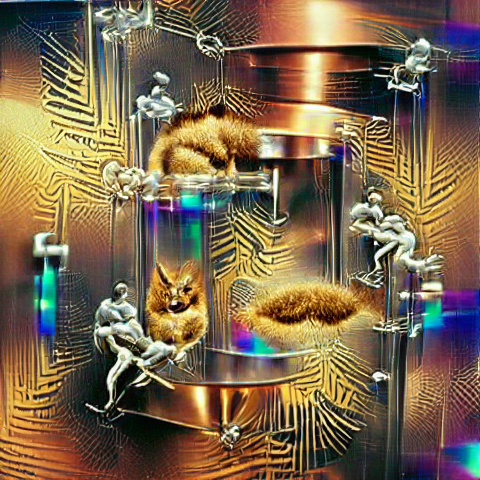

i: 2050, loss: 0.701737, losses: 0.701737


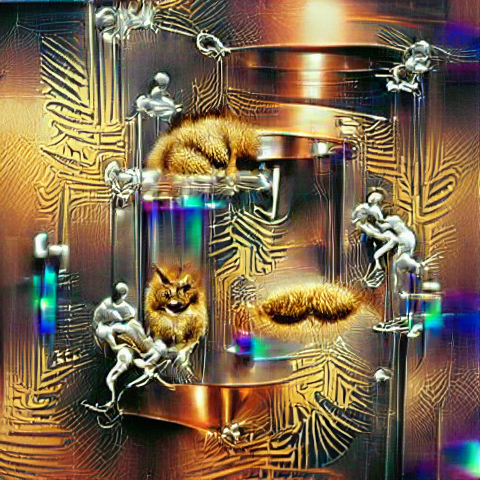

i: 2100, loss: 0.707044, losses: 0.707044


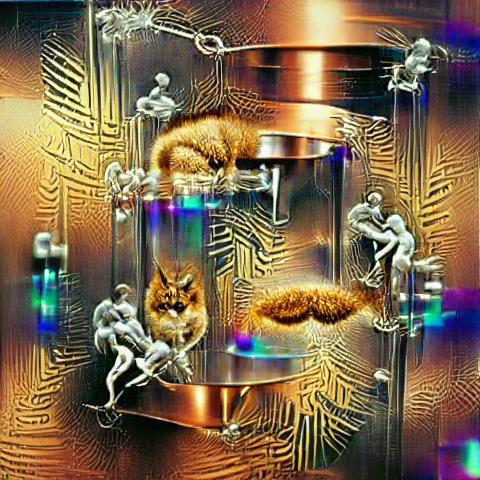

i: 2150, loss: 0.699525, losses: 0.699525


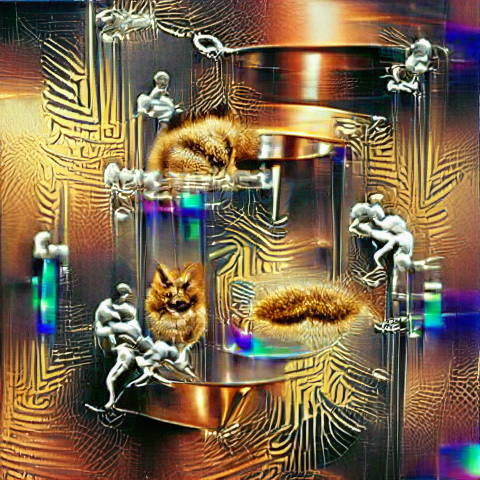

i: 2200, loss: 0.700014, losses: 0.700014


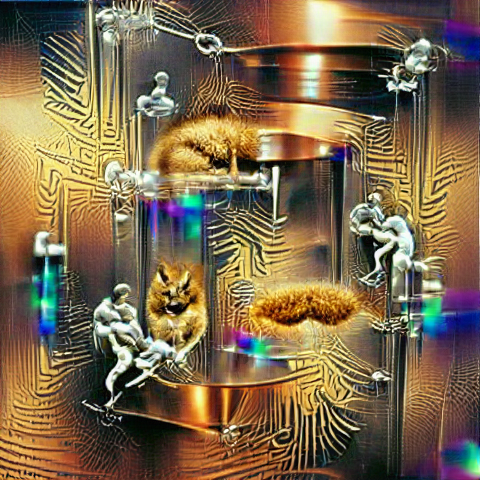

In [8]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)

model = load_vqgan_model(args.vqgan_config, args.vqgan_checkpoint).to(device)
perceptor = clip.load(args.clip_model, jit=False)[0].eval().requires_grad_(False).to(device)

cut_size = perceptor.visual.input_resolution
e_dim = model.quantize.e_dim
f = 2**(model.decoder.num_resolutions - 1)
make_cutouts = MakeCutouts(cut_size, args.cutn, cut_pow=args.cut_pow)
n_toks = model.quantize.n_e
toksX, toksY = args.size[0] // f, args.size[1] // f
sideX, sideY = toksX * f, toksY * f
z_min = model.quantize.embedding.weight.min(dim=0).values[None, :, None, None]
z_max = model.quantize.embedding.weight.max(dim=0).values[None, :, None, None]

if args.seed is not None:
    torch.manual_seed(args.seed)

if args.init_image:
    pil_image = Image.open(args.init_image).convert('RGB')
    pil_image = pil_image.resize((sideX, sideY), Image.LANCZOS)
    z, *_ = model.encode(TF.to_tensor(pil_image).to(device).unsqueeze(0) * 2 - 1)
else:
    one_hot = F.one_hot(torch.randint(n_toks, [toksY * toksX], device=device), n_toks).float()
    z = one_hot @ model.quantize.embedding.weight
    z = z.view([-1, toksY, toksX, e_dim]).permute(0, 3, 1, 2)
z_orig = z.clone()
z.requires_grad_(True)
opt = optim.Adam([z], lr=args.step_size)

normalize = transforms.Normalize(mean=[0.48145466, 0.4578275, 0.40821073],
                                 std=[0.26862954, 0.26130258, 0.27577711])

pMs = []

for prompt in args.prompts:
    txt, weight, stop = parse_prompt(prompt)
    embed = perceptor.encode_text(clip.tokenize(txt).to(device)).float()
    pMs.append(Prompt(embed, weight, stop).to(device))

for prompt in args.image_prompts:
    path, weight, stop = parse_prompt(prompt)
    img = resize_image(Image.open(path).convert('RGB'), (sideX, sideY))
    batch = make_cutouts(TF.to_tensor(img).unsqueeze(0).to(device))
    embed = perceptor.encode_image(normalize(batch)).float()
    pMs.append(Prompt(embed, weight, stop).to(device))

for seed, weight in zip(args.noise_prompt_seeds, args.noise_prompt_weights):
    gen = torch.Generator().manual_seed(seed)
    embed = torch.empty([1, perceptor.visual.output_dim]).normal_(generator=gen)
    pMs.append(Prompt(embed, weight).to(device))

def synth(z):
    z_q = vector_quantize(z.movedim(1, 3), model.quantize.embedding.weight).movedim(3, 1)
    return clamp_with_grad(model.decode(z_q).add(1).div(2), 0, 1)

@torch.no_grad()
def checkin(i, losses):
    losses_str = ', '.join(f'{loss.item():g}' for loss in losses)
    tqdm.write(f'i: {i}, loss: {sum(losses).item():g}, losses: {losses_str}')
    out = synth(z)
    TF.to_pil_image(out[0].cpu()).save('progress.png')
    display.display(display.Image('progress.png'))

def ascend_txt():
    global i
    out = synth(z)
    iii = perceptor.encode_image(normalize(make_cutouts(out))).float()

    result = []

    if args.init_weight:
        result.append(F.mse_loss(z, z_orig) * args.init_weight / 2)

    for prompt in pMs:
        result.append(prompt(iii))
    img = np.array(out.mul(255).clamp(0, 255)[0].cpu().detach().numpy().astype(np.uint8))[:,:,:]
    img = np.transpose(img, (1, 2, 0))
    imageio.imwrite('./steps/' + str(i) + '.png', np.array(img))
    return result

def train(i):
    opt.zero_grad()
    lossAll = ascend_txt()
    if i % args.display_freq == 0:
        checkin(i, lossAll)
    loss = sum(lossAll)
    loss.backward()
    opt.step()
    with torch.no_grad():
        z.copy_(z.maximum(z_min).minimum(z_max))

i = 0
try:
    with tqdm() as pbar:
        while True:
            train(i)
            i += 1
            pbar.update()
except KeyboardInterrupt:
    pass

### Genera un vídeo con los resultados

Si quieres generar un vídeo con los frames, solo haz click abajo. Puedes modificar el número de FPS, el frame inicial, el último frame, etc.

In [ ]:
init_frame = 1 #Este es el frame donde el vídeo empezará
last_frame = i #Puedes cambiar i a el número del último frame que quieres generar. It will raise an error if that number of frames does not exist.

min_fps = 10
max_fps = 30

total_frames = last_frame-init_frame

length = 15 #Tiempo deseado del vídeo en segundos

frames = []
tqdm.write('Generating video...')
for i in range(init_frame,last_frame): #
    frames.append(Image.open("./steps/"+ str(i) +'.png'))

#fps = last_frame/10
fps = np.clip(total_frames/length,min_fps,max_fps)

from subprocess import Popen, PIPE
p = Popen(['ffmpeg', '-y', '-f', 'image2pipe', '-vcodec', 'png', '-r', str(fps), '-i', '-', '-vcodec', 'libx264', '-r', str(fps), '-pix_fmt', 'yuv420p', '-crf', '17', '-preset', 'veryslow', 'video.mp4'], stdin=PIPE)
for im in frames:
    im.save(p.stdin, 'PNG')
p.stdin.close()
p.wait()
mp4 = open('video.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
display.HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)